# Exploratory Data Analysis (EDA)

**Installing and importing required libraries**

In [ ]:
import seaborn as sns
sns.set_theme(style="darkgrid")
import calendar

In [ ]:
import pandas as pd
df_final = pd.read_csv('FINAL_CORD_DATA.csv')

Inspection of final data

In [ ]:
#Inspect data
def inspect_data(data):
    return pd.DataFrame(
        {
            "Data Type": data.dtypes,
            "No of levels": data.apply(lambda x:len(x.unique()), axis=0),
            "levels": data.apply(lambda x:x.unique(), axis=0),
            "qtd_null": data.apply(lambda x: x.isnull().sum(), axis=0),
            "pct_null": data.apply(lambda x: x.isnull().sum() * 100 / len(x))
        }
    )

In [ ]:
inspect_data(df_final)

,Data Type,No of Levels,Levels,qtd_null,pct_null
sha,object,24910,['41ed6b3014e89604b351c095571c45056ba12c37'\n ...,0,0.000000
title,object,24854,['A phantom study to optimise the automatic tu...,0,0.000000
abstract,object,21795,"['On March 11, 2020, the World Health Organiza...",3067,12.312324
publish_time,object,3443,['2021-05-28' '2020-10-20' '2020-06-12' ... '1...,0,0.000000
authors,object,24525,"['Gombolevskiy, Victor; Morozov, Sergey; Chern...",218,0.875151
url,object,24910,['https://doi.org/10.1186/s41747-021-00218-0; ...,0,0.000000
body_text,object,24740,['\nWe obtained a density difference (ground-g...,0,0.000000


In [ ]:
df_final['publish_time'] = pd.to_datetime(df_final['publish_time'])

In [ ]:
df_final['publish_year'] =  df_final['publish_time'].dt.year
df_final['publish_month'] =  df_final['publish_time'].dt.month
df_final['publish_day'] =  df_final['publish_time'].dt.day


In [ ]:
df_final['publish_year'].nunique()

51

In [ ]:
df_final['publish_year'].min()

1970

In [ ]:
df_final['publish_year'].max()

2021

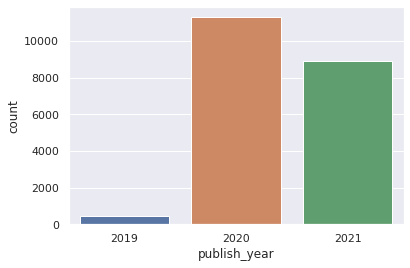

In [ ]:
# No.of papers published in recent years
sns.countplot(x="publish_year", data=df_final[df_final['publish_year'].isin([2018, 2019,2020,2021, 2022])])

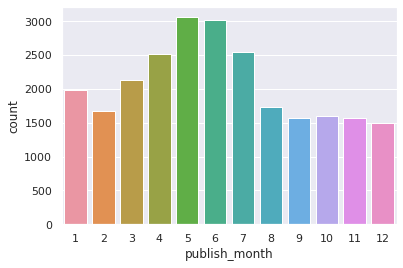

In [ ]:
#Month wise distribution of papers published
sns.countplot(x="publish_month", data=df_final)

In [ ]:
df_final['publish_month'] = df_final['publish_month'].apply(lambda x : calendar.month_abbr[x])

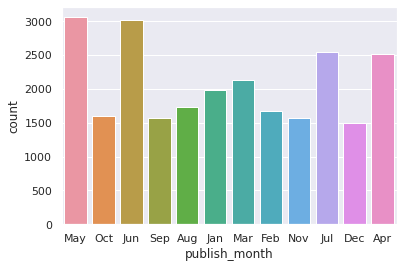

In [ ]:
sns.countplot(x="publish_month", data=df_final)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


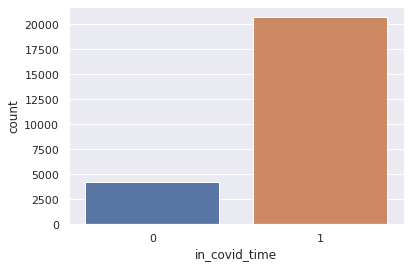

In [ ]:
#Checking % of papers published in recent times vs in earlier years
df_final['in_covid_time'] = np.where(df_final['publish_year'].isin([2019,2020,2021]), 1, 0)
sns.countplot(df_final['in_covid_time'])

**Looking at world clouds**

In [ ]:
!pip3 install wordcloud

In [ ]:
from wordcloud import WordCloud, STOPWORDS 
import re
import string

In [ ]:
def plot_word_cloud(wordcloud):
    plt.figure(figsize=(10, 10))
    plt.imshow(wordcloud) 
    plt.axis("off");

In [ ]:
def remove_special_charac_and_punctuations(text) :
  # define the pattern to keep
  pattern = r'[^a-zA-z0-9\'\s]' 
  txt = re.sub(pattern, '', text)
  txt = ''.join([c for c in txt if c not in string.punctuation])
  return  txt

In [ ]:
def concat_all_sentences(sents):
   all_tokens = ''
   for text in sents:
        tx = str(text).lower().strip()
        tx = " ".join(tx.split())
        all_tokens += tx + " "
   return all_tokens  

In [ ]:
cleaned_titles = df_final.loc[df_final.title.notnull(), 'title'].apply(remove_special_charac_and_punctuations)

In [ ]:
cleaned_abstracts = df_final.loc[df_final.abstract.notnull(), 'abstract'].apply(remove_special_charac_and_punctuations)

In [ ]:
title_tokens = concat_all_sentences(cleaned_titles)

In [ ]:
abstract_tokens = concat_all_sentences(cleaned_abstracts)

In [ ]:
title_tokens

'a phantom study to optimise the automatic tube current modulation for chest ct in covid19 tunicamycin an anticancer drug and inhibitor of n linked glycosylation proteins is reliable to treat covid19 asymptomatic sarscov2 infection electroencephalographic findings in covid19 patients a systematic review mechanical ventilator parameter estimation for lung health through machine learning coagulopathy associated with covid19 perspectives preventive strategies using a biological response modifier glucan clustering analysis of countries using the covid19 cases dataset pressioninduced facial ulcers by prone position for covid19 mechanical ventilation emerging infectious disease trends in the literature on sars and h7n9 influenza study on the dynamic change law and correlation between ct imaging manifestations and cellular immunity of 2019 novel coronavirus disease impact of the covid19 pandemic on the core functions of primary care will the cure be worse than the disease a qualitative interv

In [ ]:
abstract_tokens

'on march 11 2020 the world health organization declared the coronavirus disease 2019 covid19 pandemic the expert organisations recommend more cautious use of thoracic computed tomography ct opting for lowdose protocols we aimed at determining a threshold value of automatic tube current modulation noise index below which there is a chance to miss an onset of groundglass opacities ggo in covid19 a team of radiologists and medical physicists performed 25 phantom ct studies using different automatic tube current modulation settings sureexposure3d technology we then conducted a retrospective evaluation of the chest ct images from 22 patients with covid19 and calculated the density difference between the ggo and unaffected tissue finally the results were matched to the phantom study results to determine the minimum noise index threshold value the minimum density difference at the onset of covid19 was 252 hu p 0001 this was found to correspond to the sureexposure 3d noise index of 36 we esta

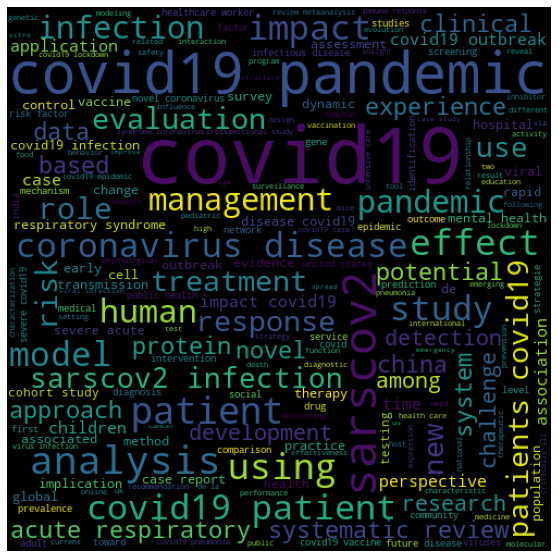

In [ ]:
#Looking at word cloud of title tokens
title_wordcloud = WordCloud(width = 500, height = 500,random_state=10).generate(title_tokens)
plot_word_cloud(title_wordcloud)

## Topic modelling

In [ ]:
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.utils import lemmatize, simple_preprocess
from gensim.models import CoherenceModel

In [ ]:
abstracts = cleaned_abstracts.values.tolist()

In [ ]:
#simple_preprocess of genism removes special charcters,numbers and converts into lower case
gensim.utils.simple_preprocess("12 happy today @# '' '\n'", deacc=True) 

['happy', 'today']

In [ ]:
def token_builder(sentences) :
   for sent in sentences:     
        sent = gensim.utils.simple_preprocess(str(sent), deacc=True) 
        yield(sent)  



In [ ]:
#Building abstract tokens using token_builder
abstract_tokens = list(token_builder(abstracts))

In [ ]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(abstract_tokens, min_count=3, threshold=50) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[abstract_tokens], threshold=50)  
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

/usr/local/lib/python3.7/dist-packages/gensim/models/phrases.py:598: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")


In [ ]:
import nltk as nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use', 'not', 'would', 'say', 'could', '_', 'be', 'know', 'good', 'go', 'get', 'do', 'done', 'try', 'many', 'some', 'nice', 'thank', 'think', 'see', 'rather', 'easy', 'easily', 'lot', 'lack', 'make', 'want', 'seem', 'run', 'need', 'even', 'right', 'line', 'even', 'also', 'may', 'take', 'come'])

In [ ]:
def process_docs(texts, stop_words=stop_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    texts = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
    texts = [bigram_mod[doc] for doc in texts]
    texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
    texts_out = []
    nlp = spacy.load('en', disable=['parser', 'ner'])
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    # remove stopwords once more after lemmatization   
    texts_out = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts_out] 
    return texts_out


In [ ]:
abstracts_data = process_docs(abstract_tokens)

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(abstracts_data)

In [ ]:
print(id2word)

Dictionary(57043 unique tokens: ['aim', 'allow', 'automatic', 'calculate', 'cautious']...)


In [ ]:
print(id2word.token2id)

{'aim': 0, 'allow': 1, 'automatic': 2, 'calculate': 3, 'cautious': 4, 'chest_ct_image': 5, 'conduct': 6, 'correspond': 7, 'covid': 8, 'current': 9, 'declare': 10, 'decrease': 11, 'density': 12, 'determine': 13, 'difference': 14, 'different': 15, 'doselength': 16, 'establish': 17, 'evaluation': 18, 'expert': 19, 'finally': 20, 'find': 21, 'index': 22, 'iterative': 23, 'lowdose': 24, 'match': 25, 'medical': 26, 'minimum': 27, 'modulation': 28, 'noise': 29, 'onset': 30, 'opt': 31, 'organisation': 32, 'patient': 33, 'perform': 34, 'phantom': 35, 'physicist': 36, 'product': 37, 'propose': 38, 'prospective': 39, 'protocol': 40, 'radiologist': 41, 'recommend': 42, 'reconstruction': 43, 'result': 44, 'retrospective': 45, 'scanner': 46, 'setting': 47, 'study': 48, 'sureexposure': 49, 'team': 50, 'technology': 51, 'threshold': 52, 'tissue': 53, 'tomography_ct': 54, 'tube': 55, 'unaffected': 56, 'validate': 57, 'value': 58, 'action': 59, 'challenge': 60, 'conclude': 61, 'control': 62, 'coronaviru

In [ ]:
# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in abstracts_data]

In [ ]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=2, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=10,
                                           passes=10,
                                           alpha='symmetric',
                                           iterations=100,
                                           per_word_topics=True)

In [ ]:
print(lda_model.print_topics())

[(0, '0.016*"virus" + 0.011*"infection" + 0.009*"cell" + 0.008*"study" + 0.007*"viral" + 0.007*"human" + 0.006*"vaccine" + 0.006*"disease" + 0.006*"protein" + 0.006*"show"'), (1, '0.020*"patient" + 0.012*"covid" + 0.010*"study" + 0.008*"result" + 0.006*"case" + 0.006*"pandemic" + 0.006*"model" + 0.006*"method" + 0.005*"include" + 0.005*"high"')]


In [ ]:
import matplotlib.pyplot as plt

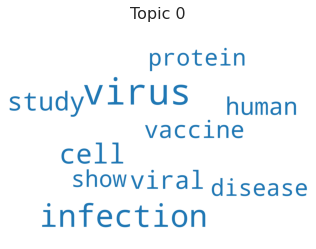

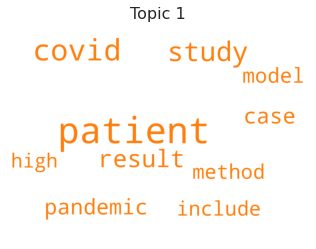

In [ ]:
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model.show_topics(formatted=False)

for i in range(0,2):
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    plt.show()

In [ ]:
topics = lda_model.show_topics(formatted=False)

In [ ]:
topics

[(0,
  [('virus', 0.015571298),
   ('infection', 0.0113191875),
   ('cell', 0.00863414),
   ('study', 0.007627632),
   ('viral', 0.0070375563),
   ('human', 0.0065719676),
   ('vaccine', 0.006460651),
   ('disease', 0.006113238),
   ('protein', 0.0061047613),
   ('show', 0.0059775)]),
 (1,
  [('patient', 0.019541455),
   ('covid', 0.012291665),
   ('study', 0.01028048),
   ('result', 0.008011131),
   ('case', 0.006446368),
   ('pandemic', 0.0062908693),
   ('model', 0.005806734),
   ('method', 0.0055235736),
   ('include', 0.0054677073),
   ('high', 0.005227228)])]